# **Soal 1: Rekaman dan Analisis Suara Multi-Level**

In [ ]:
# Import library yang dibutuhkan
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np
from IPython.display import Audio


In [ ]:
# Membaca file suara
file_path = "soal1.wav"  # pastikan file sudah diupload di sisi kiri Colab
y, sr = librosa.load(file_path, sr=None)  # sr=None agar sample rate tetap asli

# Menampilkan informasi dasar
print(f"Durasi audio: {len(y)/sr:.2f} detik")
print(f"Sample rate: {sr} Hz")

# Menampilkan audio agar bisa diputar
Audio(y, rate=sr)


Durasi audio: 25.51 detik
Sample rate: 48000 Hz


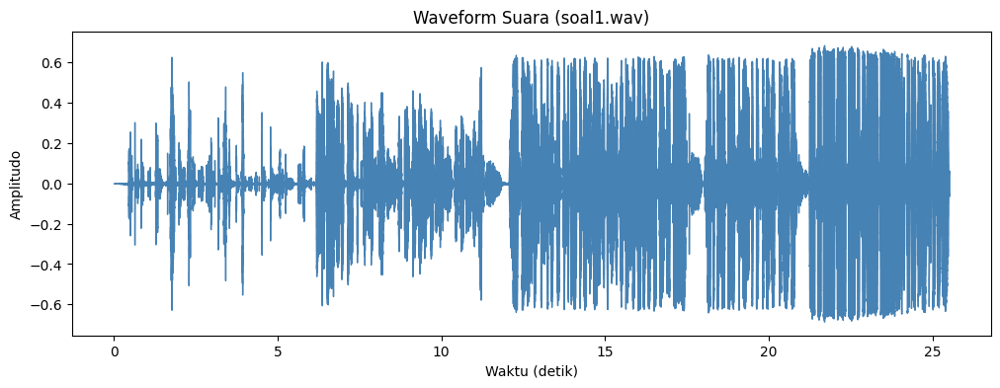

In [ ]:
# Menampilkan bentuk gelombang suara
plt.figure(figsize=(12, 4))
librosa.display.waveshow(y, sr=sr, color='steelblue')
plt.title('Waveform Suara (soal1.wav)')
plt.xlabel('Waktu (detik)')
plt.ylabel('Amplitudo')
plt.show()


Setiap bagian 5 detik menampilkan karakter suara yang berbeda sesuai instruksi pada soal.

- Detik 0–5 (suara pelan / berbisik)
Bagian awal terlihat gelombang kecil dan jarang, menandakan suara direkam dengan intensitas rendah dan tekanan udara kecil — khas suara berbisik.

- Detik 5–10 (suara normal)
Amplitudo mulai meningkat, gelombang tampak lebih tinggi dan padat dibanding sebelumnya. Ini menandakan suara sudah pada level wajar, seperti berbicara biasa.

- Detik 10–15 (suara keras)
Di bagian ini, gelombang semakin tinggi dan rapat, menunjukkan peningkatan energi suara. Suara lebih kuat dan menonjol.

- Detik 15–20 (suara cempreng)
Gelombang masih besar dan rapat, tetapi pola naik-turunnya tampak lebih tidak stabil. Ini menandakan suara memiliki frekuensi tinggi (cempreng) yang membuat grafiknya tampak “bergerigi”.

- Detik 20–25 (suara berteriak)
Bagian akhir menunjukkan amplitudo paling besar dan rapat di seluruh rekaman. Ini menandakan suara sangat kuat dan berenergi tinggi — sesuai karakter suara berteriak.

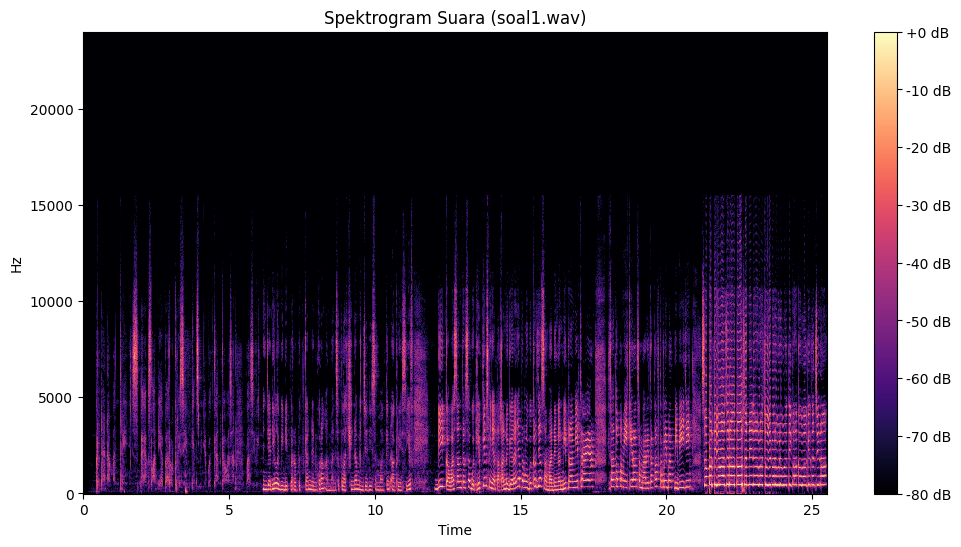

In [ ]:
# Membuat spektrogram
plt.figure(figsize=(12, 6))
D = librosa.amplitude_to_db(np.abs(librosa.stft(y)), ref=np.max)
librosa.display.specshow(D, sr=sr, x_axis='time', y_axis='hz', cmap='magma')
plt.colorbar(format='%+2.0f dB')
plt.title('Spektrogram Suara (soal1.wav)')
plt.show()

Warna menunjukkan kekuatan suara:

Warna kuning dan oranye = **suara kuat / keras**

Warna ungu tua dan hitam = **suara pelan atau tanpa suara**

Perbagian Waktunya :

- 0–5 detik (suara berbisik) :
Warna dominan gelap dan sedikit oranye di frekuensi rendah (sekitar 0–3000 Hz).

  Energi suara kecil dan hanya sedikit komponen frekuensi yang terdengar.
  
  Ini sesuai dengan suara berbisik yang cenderung pelan dan tidak memiliki nada tinggi.

- 5–10 detik (suara normal) :
Warna mulai lebih terang di bagian bawah grafik (0–5000 Hz).
  
  Energi suara meningkat, dengan sebaran frekuensi yang lebih lebar.
  
  Ini menggambarkan suara normal saat berbicara.

- 10–15 detik (suara keras) :
Warna oranye makin jelas dan menjangkau frekuensi lebih tinggi.

  Energi suara meningkat tajam, menandakan suara yang diucapkan lebih kuat.

- 15–20 detik (suara cempreng) :
Terlihat banyak warna terang di area frekuensi tinggi (sekitar 5000–10000 Hz).

  Ini khas suara cempreng, karena nada tinggi mendominasi dan energi tersebar lebih luas ke atas.

- 20–25 detik (suara berteriak) :
Hampir seluruh bagian bawah–tengah grafik (hingga sekitar 8000 Hz) dipenuhi warna terang.
  
  Ini menunjukkan energi suara sangat besar dan mencakup rentang frekuensi luas — tanda suara berteriak.

In [ ]:
# Melakukan resampling
y_resampled = librosa.resample(y, orig_sr=sr, target_sr=8000)

# Menampilkan perbandingan
print(f"Sample rate asli: {sr} Hz → durasi {len(y)/sr:.2f} detik")
print(f"Setelah resampling: 8000 Hz → durasi {len(y_resampled)/8000:.2f} detik")

# Dengar hasilnya
Audio(y_resampled, rate=8000)


Sample rate asli: 48000 Hz → durasi 25.51 detik
Setelah resampling: 8000 Hz → durasi 25.51 detik


**BEDANYA**
1. Setelah diubah ke 8000 Hz, suara jadi agak mendem karena data frekuensi tinggi dihilangkan.

2. Tapi durasi tetap sama, sekitar 25 detik.

3. Jadi perbedaan hanya di kualitas, bukan waktu.

# **Soal 2: Noise Reduction dengan Filtering**

In [ ]:
file_path = "soal2.wav"
y, sr = librosa.load(file_path, sr=None)
dur = len(y)/sr
print(f"Sample rate: {sr} Hz")
print(f"Durasi: {dur:.2f} detik")
Audio(y, rate=sr)


Sample rate: 48000 Hz
Durasi: 8.98 detik


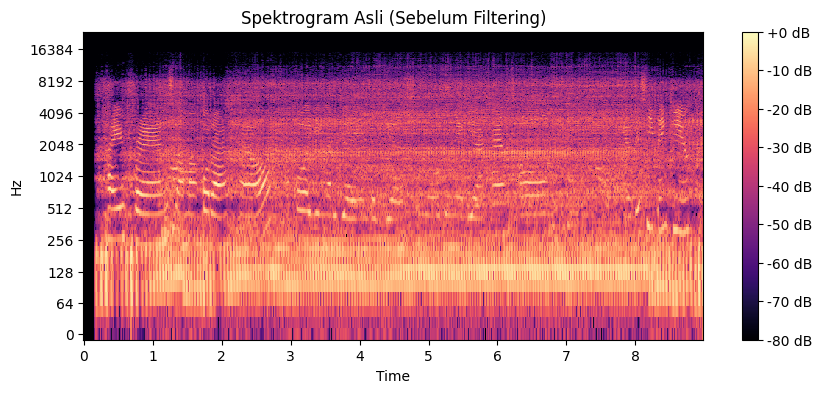

In [ ]:
# --- Tampilkan spektrogram asli ---
plt.figure(figsize=(10, 4))
D = librosa.amplitude_to_db(np.abs(librosa.stft(y)), ref=np.max)
librosa.display.specshow(D, sr=sr, x_axis='time', y_axis='log', cmap='magma')
plt.title("Spektrogram Asli (Sebelum Filtering)")
plt.colorbar(format='%+2.0f dB')
plt.show()

Gambar di atas menunjukkan spektrum suara asli dari rekaman saya yang dilakukan di dekat mesin motor yang menyala.
Pada spektrogram, area berwarna **kuning dan oranye terang** menandakan frekuensi yang **kuat atau dominan**, sedangkan **warna gelap ke ungu** menunjukkan bagian suara yang **lebih lemah**.

Terlihat bahwa bagian bawah (di bawah 500 Hz) memiliki warna yang cukup terang dan tebal.
Ini menunjukkan adanya suara bising dari mesin — berupa dengungan konstan dengan frekuensi rendah yang mendominasi hampir sepanjang rekaman.
Sementara di bagian tengah hingga atas (sekitar 1000–4000 Hz), terdapat pola gelombang ucapan manusia, namun tertimpa oleh noise mesin tadi.

Secara sederhana, bisa dibilang:
- Bagian bawah = suara mesin motor (dengung)
- Bagian tengah atas = suara saya berbicara

In [ ]:
import soundfile as sf

**Eksperimen 1 — High-pass Filter (500 Hz)**

✅ Hasil audio disimpan sebagai highpass_500Hz.wav


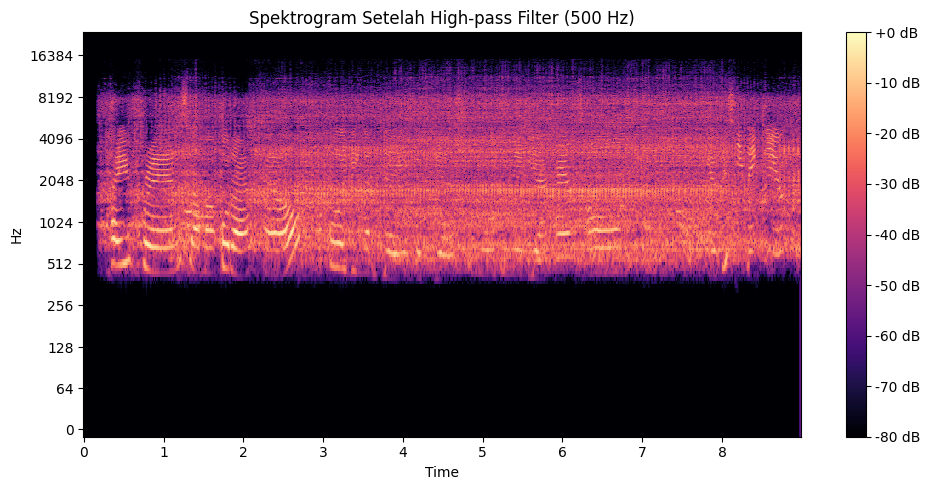

In [ ]:
# --- Load audio ---
y, sr = librosa.load("/content/soal2.wav", sr=None)

# --- Fungsi High-pass Filter ---
def highpass_filter(y, sr, cutoff):
    sos = butter(10, cutoff, btype='highpass', fs=sr, output='sos')
    return sosfiltfilt(sos, y)

# --- Terapkan Filter ---
cutoff_hp = 500  # frekuensi cutoff 500 Hz
y_hp = highpass_filter(y, sr, cutoff_hp)

# --- Simpan hasil audio ---
sf.write(f"/content/highpass_{cutoff_hp}Hz.wav", y_hp, sr)
print(f"✅ Hasil audio disimpan sebagai highpass_{cutoff_hp}Hz.wav")


# --- Tampilkan Spektrogram Setelah Filtering ---
plt.figure(figsize=(10, 5))
D_hp = librosa.amplitude_to_db(np.abs(librosa.stft(y_hp)), ref=np.max)
librosa.display.specshow(D_hp, sr=sr, x_axis='time', y_axis='log', cmap='magma')
plt.colorbar(format='%+2.0f dB')
plt.title(f"Spektrogram Setelah High-pass Filter ({cutoff_hp} Hz)")
plt.tight_layout()
plt.show()

In [ ]:
from IPython.display import Audio
Audio(f"/content/highpass_{cutoff_hp}Hz.wav")

**Analisis Eksperimen 1**

Pada gambar di atas, terlihat spektrogram suara setelah diberi **high-pass filter** dengan cutoff 500 Hz.
Artinya, frekuensi di bawah 500 Hz (bagian yang paling rendah, suara dengung mesin atau getaran) **dihilangkan atau sangat dilemahkan**, sedangkan frekuensi di atasnya tetap dipertahankan.

Hasilnya kita lihat di bagian bawah spektrogram yang sekarang **lebih gelap** — itu menandakan suara rendah sudah berkurang.
Suara saya (yang berada di frekuensi menengah dan tinggi) terdengar **lebih jelas dan bersih**, meskipun sedikit kehilangan “nada rendah” atau bass-nya.

Secara umum:

- Noise yang hilang → suara mesin motor yang berdengung di frekuensi rendah.
- Efek positif → suara ucapan lebih jelas.
- Efek samping kecil → suara terasa agak tipis karena nada rendah ikut berkurang.

**Eksperimen 2 — Low-pass Filter (800 Hz)**

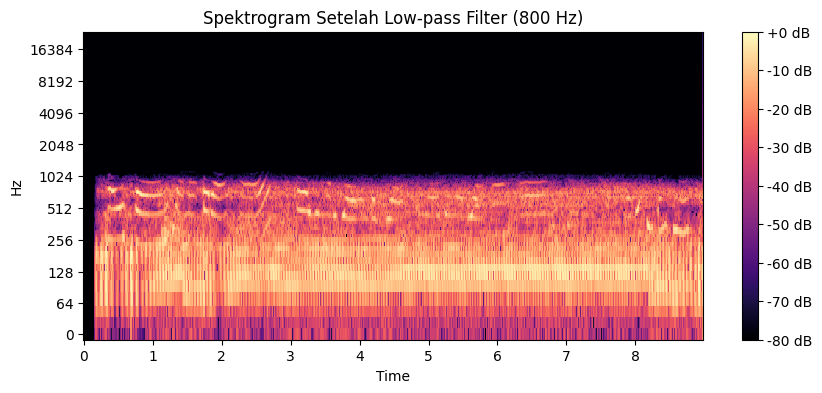

✅ Hasil audio disimpan sebagai lowpass_800Hz.wav


In [ ]:
def make_lowpass(cutoff, sr, order=10):
    W = cutoff / (sr / 2)
    sos = butter(order, W, btype='lowpass', output='sos')
    return sos

cutoff_lp = 800
sos_lp = make_lowpass(cutoff_lp, sr)
y_lp = apply_filter(y, sos_lp)

# --- Tampilkan spektrogram hasil ---
plt.figure(figsize=(10, 4))
D_lp = librosa.amplitude_to_db(np.abs(librosa.stft(y_lp)), ref=np.max)
librosa.display.specshow(D_lp, sr=sr, x_axis='time', y_axis='log', cmap='magma')
plt.title(f"Spektrogram Setelah Low-pass Filter ({cutoff_lp} Hz)")
plt.colorbar(format='%+2.0f dB')
plt.show()

# --- Simpan hasil audio ---
sf.write(f"/content/lowpass_{cutoff_lp}Hz.wav", y_lp, sr)
print(f"✅ Hasil audio disimpan sebagai lowpass_{cutoff_lp}Hz.wav")


In [ ]:
from IPython.display import Audio
Audio(f"/content/lowpass_{cutoff_lp}Hz.wav")


**Analisis Eksperimen 2**

Pada gambar di atas, terlihat spektrogram suara setelah diberi **low-pass filter** dengan cutoff 800 Hz.
Artinya, hanya suara dengan frekuensi **di bawah 800 Hz yang dibiarkan lewat**, sedangkan suara yang lebih tinggi (seperti nada tajam atau suara manusia yang dominan di atas 1000 Hz) **dihilangkan atau dilemahka**n.

Dari hasilnya, bisa dilihat bagian atas spektrogram (frekuensi tinggi) menjadi **lebih gelap**, menandakan energi suara di frekuensi tinggi telah berkurang.
Akibatnya, noise tajam atau desis dari mesin motor memang berkurang, tapi di sisi lain, **suara ucapan juga jadi agak tenggelam dan kurang jelas**, karena sebagian besar komponen suara manusia ada di frekuensi menengah–tinggi.

Secara umum:

- Noise yang berkurang: suara desis atau getaran tinggi dari mesin.
- Efek positif: suara jadi lebih lembut dan tidak “nyaring”.
- Efek negatif: ucapan jadi agak mendem (seperti tertutup) dan kurang jelas.

**Eksperimen 3 — Band-pass Filter (500–2000 Hz)**

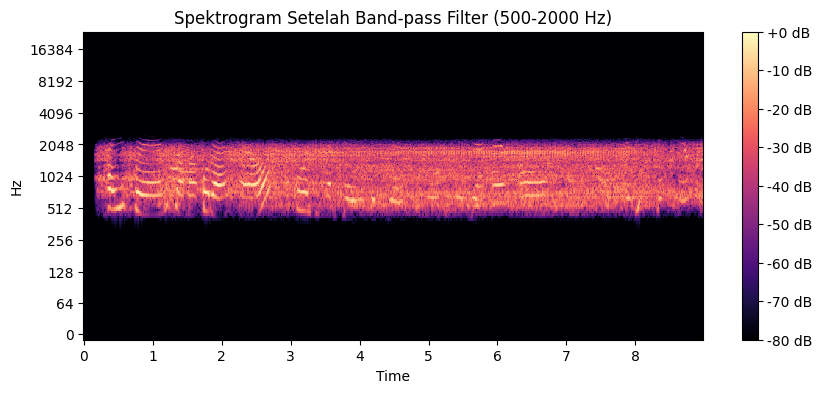

✅ Hasil audio disimpan sebagai bandpass_500-2000Hz.wav


In [ ]:
def make_bandpass(lowcut, highcut, sr, order=10):
    W = [lowcut / (sr / 2), highcut / (sr / 2)]
    sos = butter(order, W, btype='bandpass', output='sos')
    return sos

lowcut, highcut = 500, 2000
sos_bp = make_bandpass(lowcut, highcut, sr)
y_bp = apply_filter(y, sos_bp)

# --- Tampilkan spektrogram hasil ---
plt.figure(figsize=(10, 4))
D_bp = librosa.amplitude_to_db(np.abs(librosa.stft(y_bp)), ref=np.max)
librosa.display.specshow(D_bp, sr=sr, x_axis='time', y_axis='log', cmap='magma')
plt.title(f"Spektrogram Setelah Band-pass Filter ({lowcut}-{highcut} Hz)")
plt.colorbar(format='%+2.0f dB')
plt.show()

# --- Simpan hasil audio ---
sf.write(f"/content/bandpass_{lowcut}-{highcut}Hz.wav", y_bp, sr)
print(f"✅ Hasil audio disimpan sebagai bandpass_{lowcut}-{highcut}Hz.wav")


In [ ]:
from IPython.display import Audio
Audio(f"/content/bandpass_{lowcut}-{highcut}Hz.wav")

**Analisis Eksperimen 3**

Pada eksperimen ini, digunakan band-pass filter dengan rentang 500 Hz hingga 2000 Hz.
Artinya, hanya frekuensi **di antara 500–2000 Hz** yang **dibiarkan lewat**, sedangkan frekuensi di bawah 500 Hz (bass, getaran rendah) dan frekuensi di atas 2000 Hz (nada tinggi, desis, noise halus) **akan dihilangkan atau sangat dilemahkan**.

Hasilnya bisa dilihat di spektrogram:
- Warna terang hanya muncul pada bagian tengah sumbu frekuensi (500–2000 Hz).
- Bagian bawah dan atas terlihat gelap, menandakan energi suara di luar rentang tersebut hilang.

Efeknya terhadap suara:
- Suara ucapan masih terdengar, karena sebagian besar formant (komponen utama suara manusia) ada di rentang ini.
- Namun, suara jadi lebih datar — tidak ada bass dan juga tidak ada treble.
- Noise halus dari mesin atau desis berkurang cukup signifikan.

Dengan kata lain, filter ini mempertahankan bagian penting dari suara manusia, sambil mengurangi noise di luar rentang tengah.

**JAWAB**

1. Jenis noise yang muncul pada rekaman :
Noise frekuensi tinggi **(high-frequency noise)**, berupa dengungan halus atau desisan (hiss).
Ini terlihat dari area atas pada spektrogram (di atas ±2000 Hz) yang cukup padat sebelum difilter.Noise dominan berada di frekuensi tinggi.

2. Filter yang paling efektif untuk mengurangi noise tersebut : Low-pass filter (800 Hz)
- Filter ini sangat baik menghilangkan noise berfrekuensi tinggi karena **hanya melewatkan nada rendah sampai menengah**.
- Pada spektrogram hasil low-pass, terlihat bahwa frekuensi di atas ±800 Hz sudah benar-benar hilang (hitam pekat).
- Band-pass filter (500–2000 Hz) juga membantu, tetapi sebagian noise tinggi di atas 1000 Hz masih tersisa sehingga hasilnya tidak sebersih low-pass.

3. Nilai cutoff yang memberikan hasil terbaik : cutoff di 800 Hz memberikan hasil terbaik untuk reduksi noise tanpa menghilangkan terlalu banyak komponen penting ucapan.
- Jika cutoff terlalu rendah (misalnya 300–400 Hz), suara ucapan akan terdengar mendem dan tidak jelas.
- Namun pada 800 Hz, intonasi dan formant utama suara manusia masih terjaga, sementara noise di atasnya berkurang drastis.

4. Kualitas suara (kejelasan ucapan) setelah proses filtering
- Setelah low-pass filtering (800 Hz):
Suara terdengar **lebih bersih dan tenang**, tetapi sedikit kurang tajam. Nada tinggi seperti konsonan “s”, “f”, dan “t” menjadi agak lembut karena frekuensi tinggi dihilangkan.

- Setelah band-pass filtering (500–2000 Hz):
Suara tetap cukup jelas, dan artikulasi kata masih bisa dikenali. Namun noise tinggi tidak hilang sepenuhnya, jadi hasilnya tidak sebersih low-pass.
**bold text**
Dengan kata lain:
- Low-pass 800 Hz = **paling bersih tapi sedikit mendem**
Band-pass 500–2000 Hz = lebih natural tapi sedikit noise tersisa

# **Soal 3: Pitch Shifting dan Audio Manipulation**

In [ ]:
# --- Load rekaman asli ---
y, sr = librosa.load('/content/soal1.wav', sr=None)

In [ ]:
file_path = "soal1.wav"  # pastikan file sudah diupload di sisi kiri Colab
y, sr = librosa.load(file_path, sr=None)  # sr=None agar sample rate tetap asli

# Menampilkan informasi dasar
print(f"Durasi audio: {len(y)/sr:.2f} detik")
print(f"Sample rate: {sr} Hz")

# Menampilkan audio agar bisa diputar
Audio(y, rate=sr)

Durasi audio: 25.51 detik
Sample rate: 48000 Hz


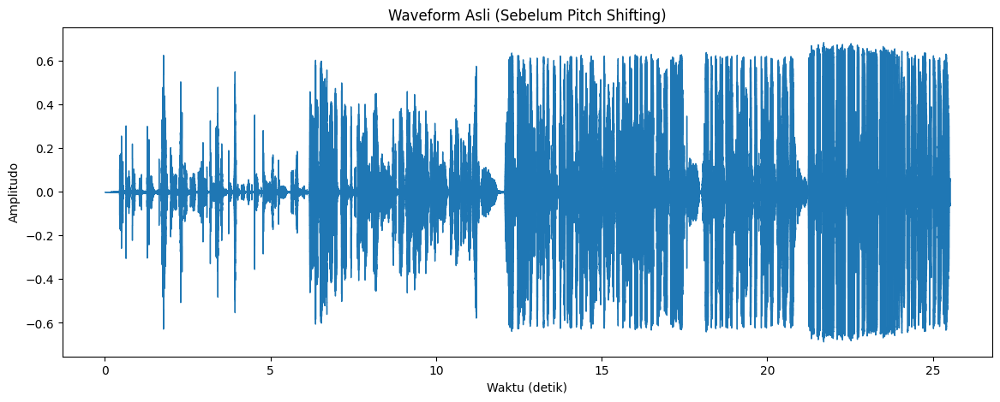

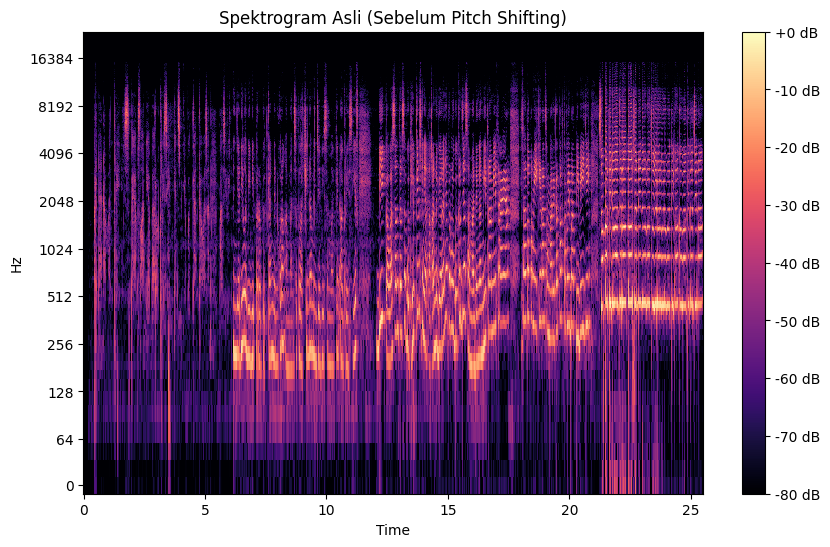

In [ ]:
import librosa.display
import matplotlib.pyplot as plt

# Tampilkan waveform dan spektrogram suara asli
plt.figure(figsize=(14,5))
librosa.display.waveshow(y, sr=sr)
plt.title("Waveform Asli (Sebelum Pitch Shifting)")
plt.xlabel("Waktu (detik)")
plt.ylabel("Amplitudo")
plt.show()

plt.figure(figsize=(10,6))
D = librosa.amplitude_to_db(np.abs(librosa.stft(y)), ref=np.max)
librosa.display.specshow(D, sr=sr, x_axis='time', y_axis='log', cmap='magma')
plt.colorbar(format="%+2.0f dB")
plt.title("Spektrogram Asli (Sebelum Pitch Shifting)")
plt.show()


**TEST 1 pitch +7**

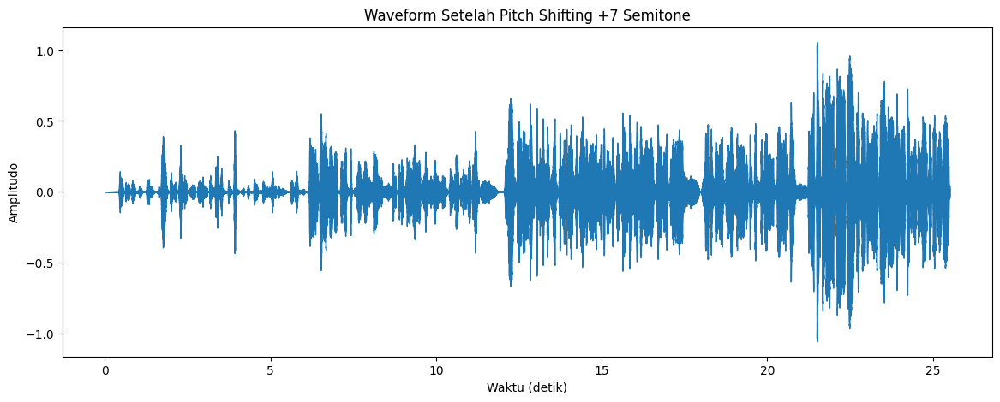

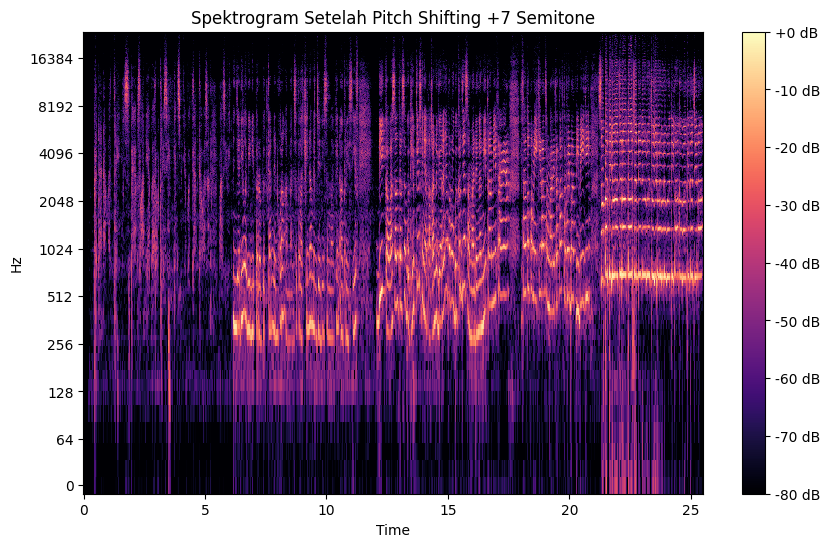

In [ ]:
# Pitch Shifting +7
y_pitch7 = librosa.effects.pitch_shift(y, sr=sr, n_steps=7)

# Simpan hasil
sf.write("pitchshift_+7.wav", y_pitch7, sr)

# Visualisasi hasil
plt.figure(figsize=(14,5))
librosa.display.waveshow(y_pitch7, sr=sr)
plt.title("Waveform Setelah Pitch Shifting +7 Semitone")
plt.xlabel("Waktu (detik)")
plt.ylabel("Amplitudo")
plt.show()

plt.figure(figsize=(10,6))
D7 = librosa.amplitude_to_db(np.abs(librosa.stft(y_pitch7)), ref=np.max)
librosa.display.specshow(D7, sr=sr, x_axis='time', y_axis='log', cmap='magma')
plt.colorbar(format="%+2.0f dB")
plt.title("Spektrogram Setelah Pitch Shifting +7 Semitone")
plt.show()


In [ ]:
import IPython.display as ipd

# Tampilkan dan putar audio hasil pitch shifting +7
ipd.Audio("pitchshift_+7.wav")


**Analisis Test 1**

- **Sebelum** dilakukan proses pitch shifting, suara terdengar dengan nada asli seperti saat direkam. **Setelah **pitch dinaikkan sebanyak **+7 semitone**, suara menjadi **lebih tinggi dan ringan**, menyerupai karakter suara chipmunk.

- Pada gambar waveform **sebelum** pitch shifting, bentuk gelombang masih menunjukkan intensitas suara normal, dengan amplitudo (ketinggian gelombang) yang relatif stabil.

  Namun pada waveform **setelah** pitch shifting, pola gelombangnya terlihat lebih rapat, menandakan adanya **peningkatan frekuensi suara**.

- Sementara pada spektrogram** setelah** pitch shifting, warna-warna terang yang menunjukkan energi frekuensi tinggi** berpindah** ke posisi yang lebih atas (bagian frekuensi tinggi). Ini berarti nada-nada suara telah naik.

- Secara umum, peningkatan pitch membuat suara terdengar lebih cerah, tetapi bisa mengurangi sedikit kejernihan atau naturalitas suara karena perubahan formant alami manusia.

**TEST 2 pitch +12**

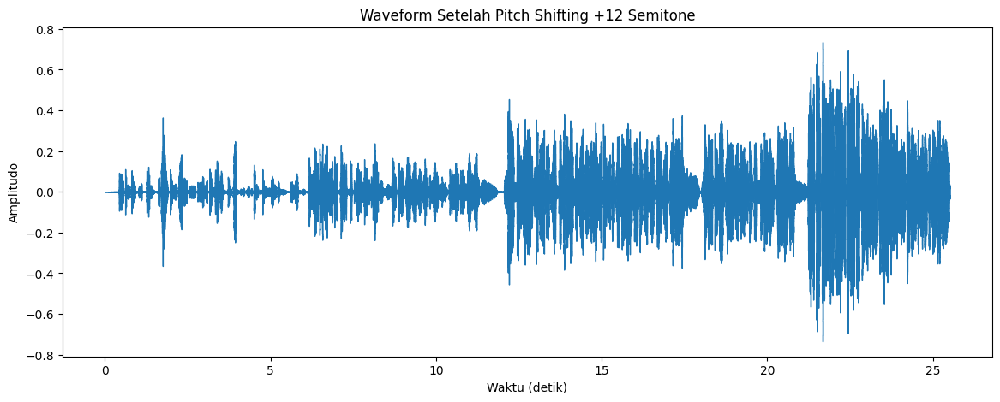

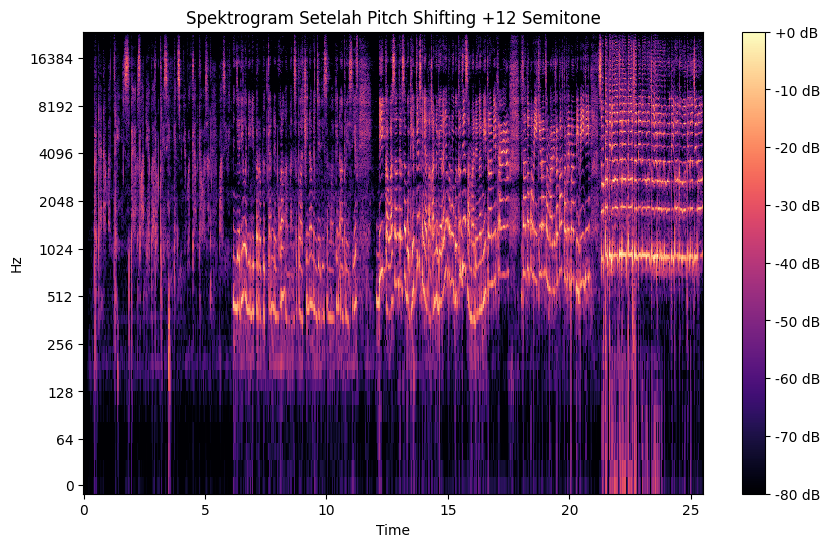

In [ ]:
# Pitch Shifting +12
y_pitch12 = librosa.effects.pitch_shift(y, sr=sr, n_steps=12)

# Simpan hasil
sf.write("pitchshift_+12.wav", y_pitch12, sr)

# Visualisasi hasil
plt.figure(figsize=(14,5))
librosa.display.waveshow(y_pitch12, sr=sr)
plt.title("Waveform Setelah Pitch Shifting +12 Semitone")
plt.xlabel("Waktu (detik)")
plt.ylabel("Amplitudo")
plt.show()

plt.figure(figsize=(10,6))
D12 = librosa.amplitude_to_db(np.abs(librosa.stft(y_pitch12)), ref=np.max)
librosa.display.specshow(D12, sr=sr, x_axis='time', y_axis='log', cmap='magma')
plt.colorbar(format="%+2.0f dB")
plt.title("Spektrogram Setelah Pitch Shifting +12 Semitone")
plt.show()


In [ ]:
import IPython.display as ipd
ipd.Audio("pitchshift_+12.wav")


**Analisis Test 2**

  Gambar waveform menampilkan bentuk gelombang suara setelah dilakukan pitch shifting sebesar +12 semitone atau naik satu oktaf.
- Terlihat bahwa bentuk gelombang masih menyerupai suara asli, tetapi jarak antar gelombang menjadi lebih rapat.
- Hal ini menunjukkan bahwa frekuensi suara meningkat sehingga menghasilkan nada yang lebih tinggi dan terdengar seperti suara chipmunk.

Spektrogram setelah Pitch Shifting +12 Semitone memperlihatkan perubahan frekuensi suara terhadap waktu setelah dilakukan pitch shifting.
- Warna yang lebih terang menunjukkan bagian suara dengan intensitas yang lebih kuat.
- Terlihat bahwa sebagian besar pola frekuensi berpindah ke area yang lebih tinggi, menandakan bahwa nada suara naik secara signifikan.
- Suara terdengar lebih nyaring, ringan, dan lebih tinggi dibandingkan suara aslinya.

**TEST 3**

In [ ]:
import numpy as np

# Gabungkan dua hasil secara berurutan
combined = np.concatenate((y_pitch7, y_pitch12))

sf.write("combined_pitchshift.wav", combined, sr)
print("✅ File gabungan disimpan sebagai combined_pitchshift.wav")


✅ File gabungan disimpan sebagai combined_pitchshift.wav


In [ ]:
import IPython.display as ipd
ipd.Audio("combined_pitchshift.wav")

**JAWAB**

1. Penjelasan Proses Pitch Shifting
- Pada percobaan ini, dilakukan pitch shifting untuk mengubah nada suara dari rekaman asli agar terdengar lebih tinggi, seperti suara chipmunk. Proses ini dilakukan menggunakan fungsi librosa.effects.pitch_shift() pada Python.

2. Parameter yang Digunakan
- File input: rekaman suara dari Soal 1 (format WAV, durasi 25 detik).
- n_steps:

  +7 semitone → untuk menaikkan pitch setengah oktaf.

  +12 semitone → untuk menaikkan pitch satu oktaf penuh.

Nilai n_steps inilah yang menentukan seberapa tinggi atau rendah nada suara diubah. **Semakin besar** nilainya, **semakin tinggi nada** yang dihasilkan.

3. Perbedaan Visual Suara Asli dan Suara yang Dimodifikasi

Dari hasil visualisasi:
- Waveform suara asli menunjukkan pola gelombang yang renggang dan stabil, menandakan nada normal.
  
  Waveform setelah pitch shifting tampak lebih rapat, menandakan peningkatan frekuensi suara.

- Pada spektrogram suara asli, warna terang (frekuensi tinggi) berada di bagian tengah grafik.
  
  Sedangkan pada spektrogram hasil pitch shifting, warna terang berpindah ke bagian atas, menandakan kenaikan frekuensi suara.

Perbedaan ini terlihat jelas baik pada pitch +7 maupun pitch +12 semitone — **semakin besar** nilai pitch,** semakin tinggi** pergeseran warna pada spektrogram.

4. Dampak Perubahan Pitch terhadap Kualitas dan Kejelasan Suara

Setelah dilakukan pitch shifting:

- Pitch +7 semitone menghasilkan suara yang lebih cerah dan ringan, namun masih cukup jelas dan bisa dikenali sebagai suara manusia.

- Pitch +12 semitone membuat suara terdengar jauh lebih tinggi, seperti karakter chipmunk. Walau terdengar lucu dan unik, kejelasan artikulasi kata sedikit berkurang karena perubahan formant suara alami manusia.

Secara keseluruhan, pitch shifting dapat mengubah karakter suara tanpa mengubah durasi, namun peningkatan pitch yang terlalu tinggi dapat membuat suara terdengar tidak natural.

In [ ]:
audio_path = "/content/combined_pitchshift.wav"
y, sr = librosa.load(audio_path, sr=None)

In [ ]:
# Fungsi bantu untuk menampilkan waveform & spektrogram
def show_audio_info(y, sr, title):
    plt.figure(figsize=(12,4))
    librosa.display.waveshow(y, sr=sr)
    plt.title(f"Waveform - {title}")
    plt.xlabel("Waktu (detik)")
    plt.ylabel("Amplitudo")
    plt.show()

    plt.figure(figsize=(10,4))
    S = librosa.amplitude_to_db(np.abs(librosa.stft(y)), ref=np.max)
    librosa.display.specshow(S, sr=sr, x_axis='time', y_axis='log', cmap='magma')
    plt.colorbar(format='%+2.0f dB')
    plt.title(f"Spektrogram - {title}")
    plt.show()

# Fungsi bantu untuk normalisasi LUFS
def normalize_lufs(y, sr, target_loudness=-16.0):
    meter = pyln.Meter(sr)
    loudness = meter.integrated_loudness(y)
    y_norm = pyln.normalize.loudness(y, loudness, target_loudness)
    return y_norm

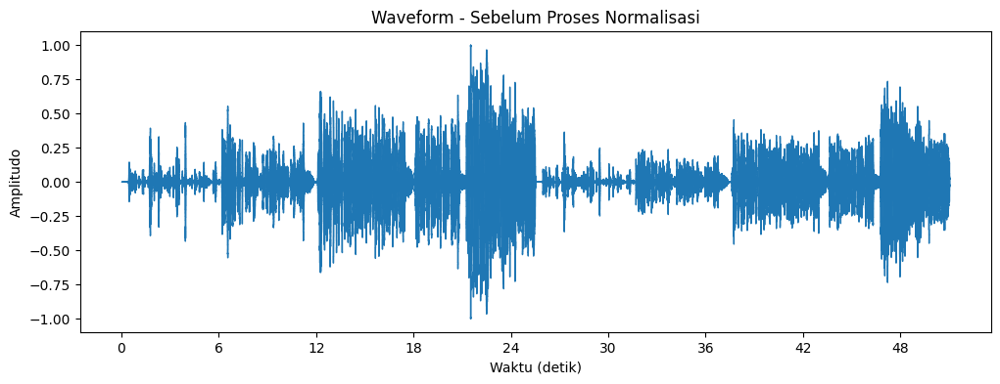

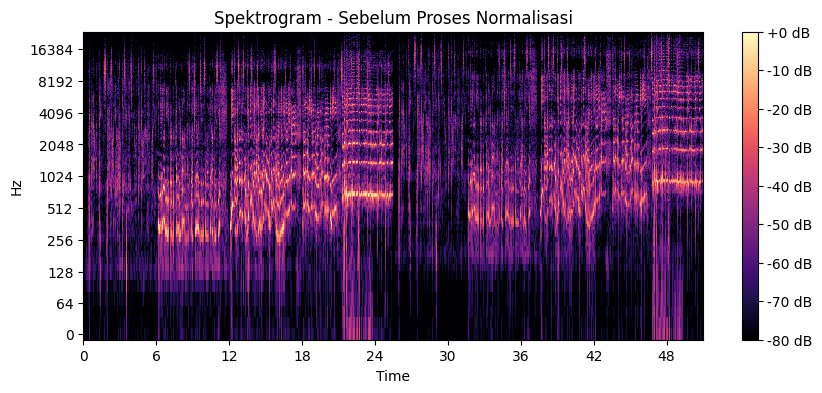

In [ ]:
show_audio_info(y, sr, "Sebelum Proses Normalisasi")


In [ ]:
!pip install pyloudnorm
import pyloudnorm as pyln

**1. Equalizer**

**Tujuan: memperbaiki keseimbangan frekuensi (menambah bass dan sedikit menghaluskan suara tinggi). bold text**

/usr/local/lib/python3.12/dist-packages/pyloudnorm/normalize.py:62: UserWarning: Possible clipped samples in output.
  warnings.warn("Possible clipped samples in output.")


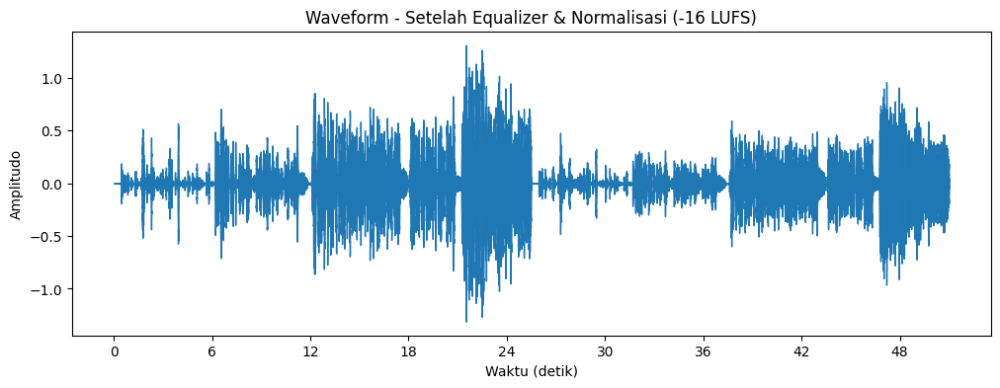

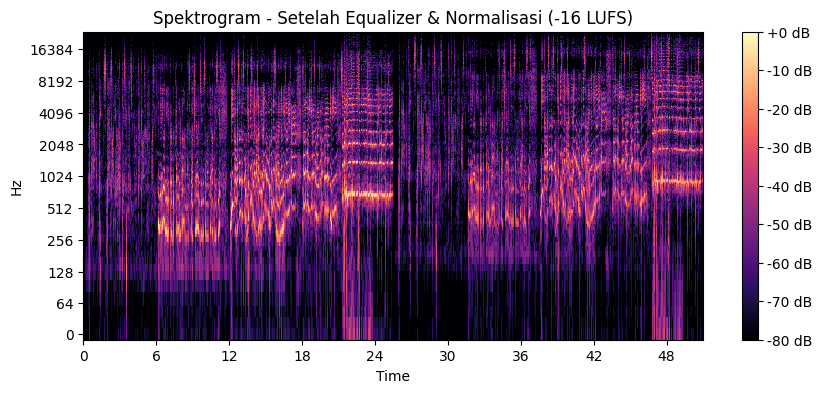

In [ ]:
import scipy.signal as signal

# EQ sederhana - menambah sedikit bass
b, a = signal.butter(2, 200/(sr/2), btype='low')
low_freq = signal.lfilter(b, a, y)
y_eq = y + 0.2 * low_freq  # campur frekuensi rendah ke suara asli

# Normalisasi ke -16 LUFS
y_eq_norm = normalize_lufs(y_eq, sr)

# Simpan hasil
sf.write("/content/eq_output.wav", y_eq_norm, sr)

# Output visualisasi
show_audio_info(y_eq_norm, sr, "Setelah Equalizer & Normalisasi (-16 LUFS)")


In [ ]:
import IPython.display as ipd
ipd.Audio("/content/eq_output.wav")

**2. Gain / Fade**

**Tujuan: membuat suara naik secara halus di awal dan menurun lembut di akhir.**

/usr/local/lib/python3.12/dist-packages/pyloudnorm/normalize.py:62: UserWarning: Possible clipped samples in output.
  warnings.warn("Possible clipped samples in output.")


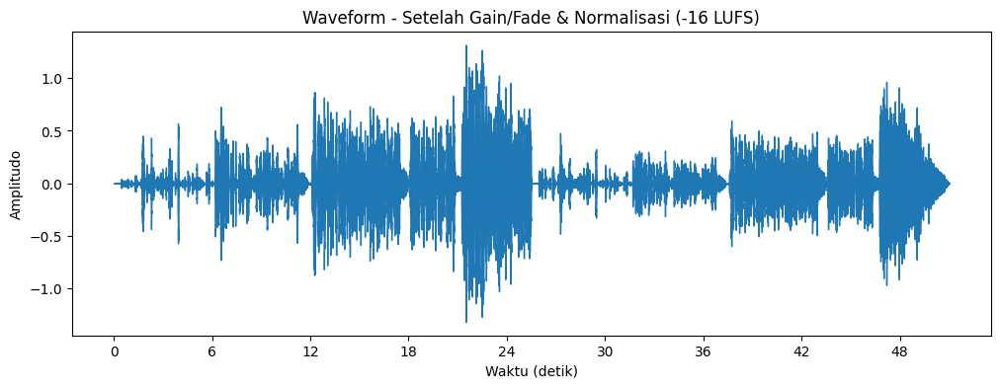

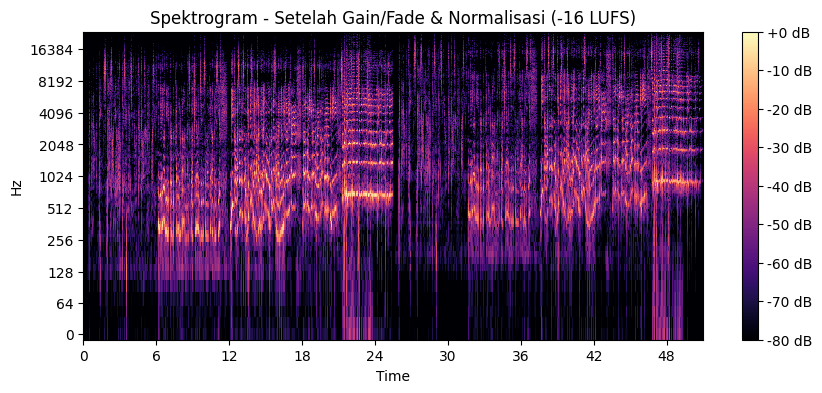

In [ ]:
fade_len = int(sr * 2)  # durasi 2 detik
fade_in = np.linspace(0, 1, fade_len)
fade_out = np.linspace(1, 0, fade_len)

y_gain = np.copy(y)
y_gain[:fade_len] *= fade_in
y_gain[-fade_len:] *= fade_out

# Normalisasi -16 LUFS
y_gain_norm = normalize_lufs(y_gain, sr)
sf.write("/content/gain_output.wav", y_gain_norm, sr)

show_audio_info(y_gain_norm, sr, "Setelah Gain/Fade & Normalisasi (-16 LUFS)")


**3. Normalization**

**Tujuan: memastikan seluruh audio punya volume seimbang tanpa melebihi batas.**

/usr/local/lib/python3.12/dist-packages/pyloudnorm/normalize.py:62: UserWarning: Possible clipped samples in output.
  warnings.warn("Possible clipped samples in output.")


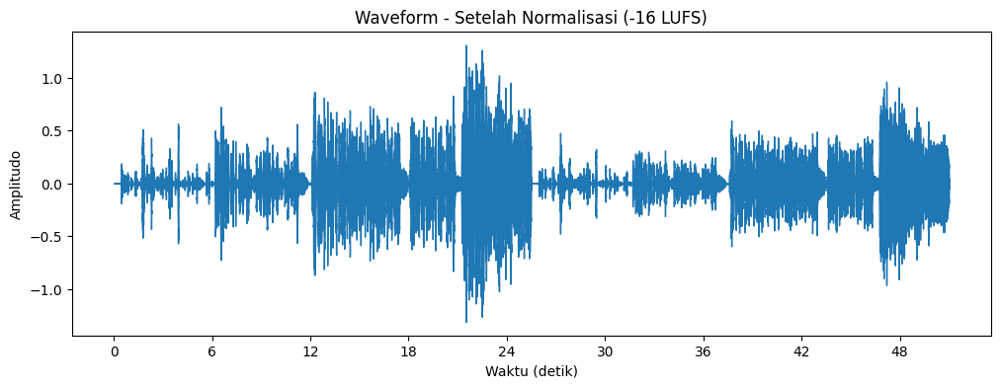

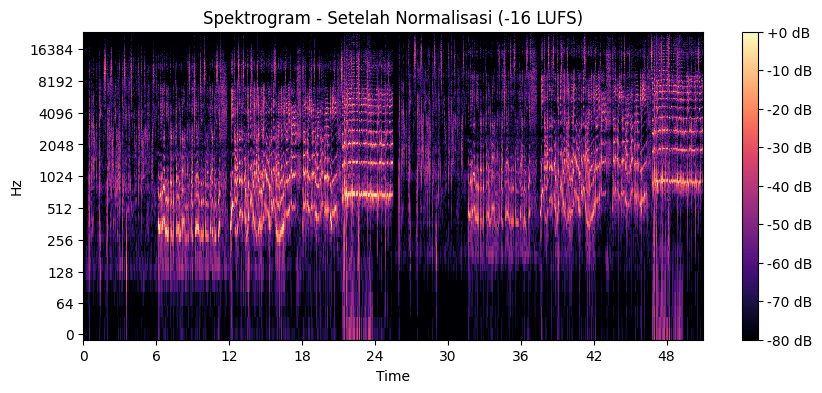

In [ ]:
y_peak_norm = y / np.max(np.abs(y))
y_norm_lufs = normalize_lufs(y_peak_norm, sr)
sf.write("/content/normalization_output.wav", y_norm_lufs, sr)

show_audio_info(y_norm_lufs, sr, "Setelah Normalisasi (-16 LUFS)")


**4. Compression**

**Tujuan: mengurangi perbedaan antara bagian keras dan lembut supaya volume terasa lebih stabil.**

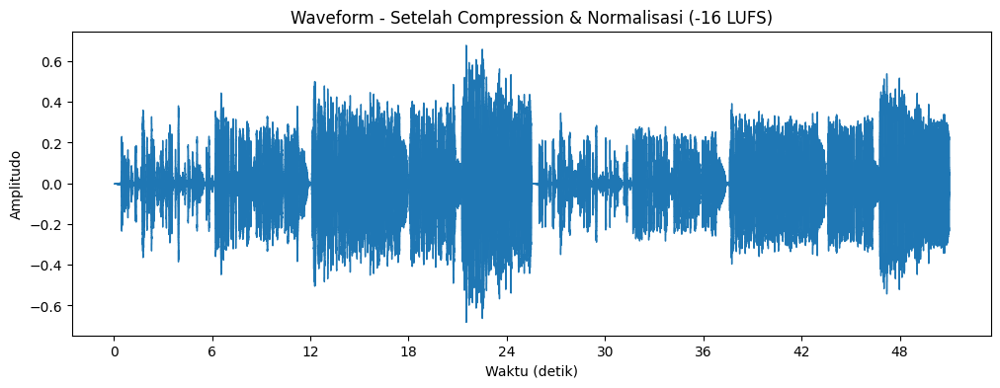

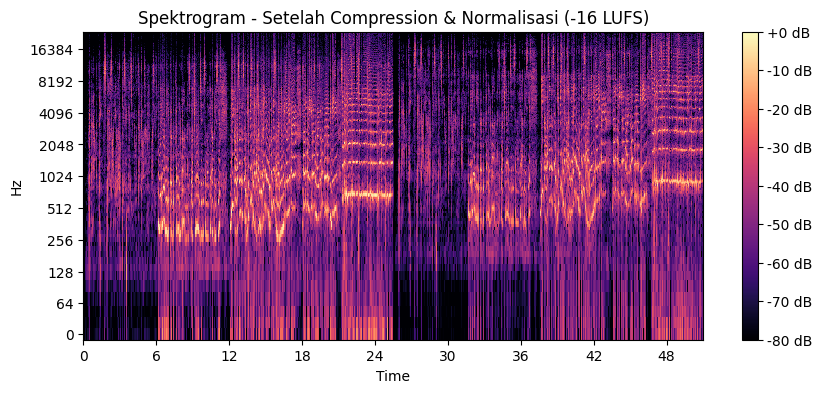

In [ ]:
def simple_compressor(signal, threshold=-20, ratio=4):
    threshold_lin = 10**(threshold/20)
    out = np.copy(signal)
    for i in range(len(signal)):
        if abs(signal[i]) > threshold_lin:
            out[i] = np.sign(signal[i]) * (threshold_lin + (abs(signal[i]) - threshold_lin) / ratio)
    return out

y_comp = simple_compressor(y, threshold=-20, ratio=4)
y_comp_norm = normalize_lufs(y_comp, sr)
sf.write("/content/compression_output.wav", y_comp_norm, sr)

show_audio_info(y_comp_norm, sr, "Setelah Compression & Normalisasi (-16 LUFS)")


**5. Noise Gate**

**Tujuan: menghilangkan bagian suara yang terlalu pelan atau hanya berupa dengungan.**

/usr/local/lib/python3.12/dist-packages/pyloudnorm/normalize.py:62: UserWarning: Possible clipped samples in output.
  warnings.warn("Possible clipped samples in output.")


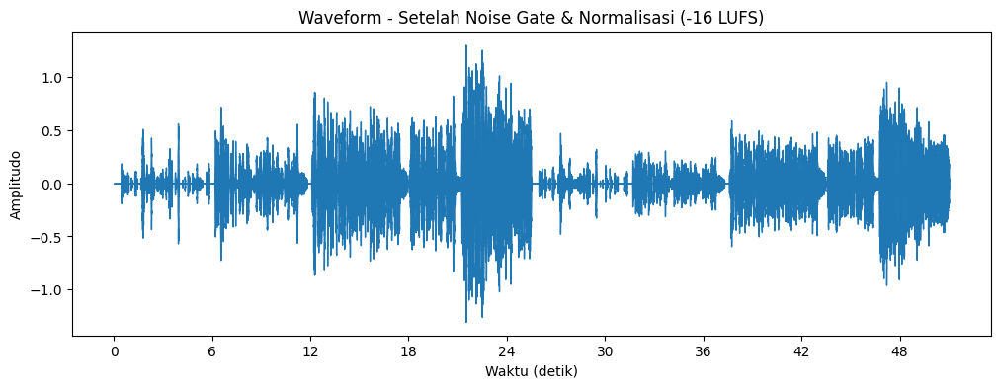

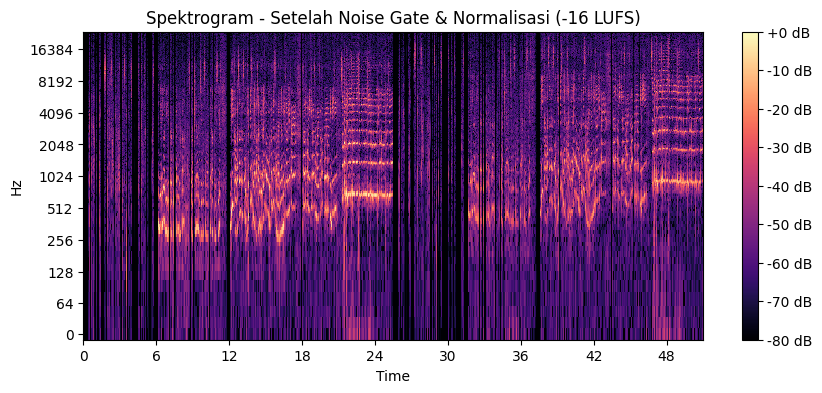

In [ ]:
threshold = 0.02
y_gate = np.where(np.abs(y) < threshold, 0, y)
y_gate_norm = normalize_lufs(y_gate, sr)
sf.write("/content/noisegate_output.wav", y_gate_norm, sr)

show_audio_info(y_gate_norm, sr, "Setelah Noise Gate & Normalisasi (-16 LUFS)")


**6. Silence Trimming**

**Tujuan: menghapus bagian hening di awal atau akhir rekaman.**

/usr/local/lib/python3.12/dist-packages/pyloudnorm/normalize.py:62: UserWarning: Possible clipped samples in output.
  warnings.warn("Possible clipped samples in output.")


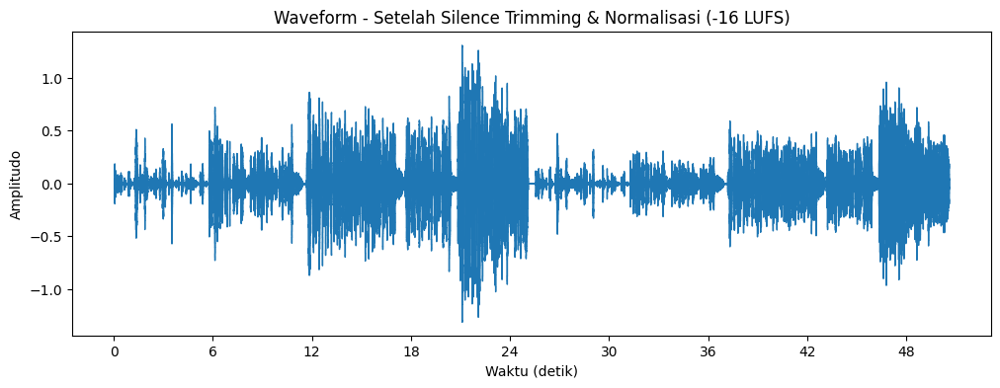

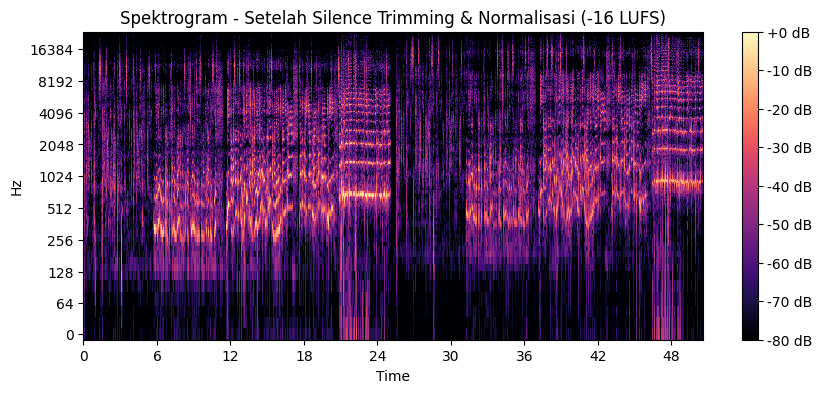

In [ ]:
y_trimmed, idx = librosa.effects.trim(y, top_db=30)
y_trimmed_norm = normalize_lufs(y_trimmed, sr)
sf.write("/content/silence_trim_output.wav", y_trimmed_norm, sr)

show_audio_info(y_trimmed_norm, sr, "Setelah Silence Trimming & Normalisasi (-16 LUFS)")


In [ ]:
import IPython.display as ipd
ipd.Audio("/content/silence_trim_output.wav")

**JAWAB**

1. Perubahan dinamika suara yang terjadi
- Setelah normalisasi dan loudness optimization, suara menjadi lebih seimbang antara bagian pelan dan keras.
- Bagian suara yang pelan menjadi lebih terdengar jelas.
- Bagian yang terlalu keras dikurangi agar tidak mendominasi.
Secara keseluruhan, volume terdengar lebih rata dan nyaman di telinga.

2. Perbedaan antara normalisasi peak dan normalisasi LUFS
- Normalisasi Peak berfokus pada puncak sinyal audio agar tidak melebihi batas (0 dB).
- Tujuannya mencegah suara pecah (clipping).
- Namun, hasilnya tidak selalu membuat volume terdengar rata.
- Normalisasi LUFS mengatur persepsi kerasnya suara berdasarkan standar pendengaran manusia.
Tujuannya menyamakan kenyamanan dengar antar rekaman.
- Prosesnya lebih kompleks karena melibatkan pengukuran loudness secara keseluruhan, bukan hanya puncak sinyal.

 3. Perubahan kualitas suara setelah normalisasi dan loudness optimization
- Suara terdengar lebih konsisten di seluruh bagian rekaman.
- Volume tidak terlalu naik-turun, sehingga lebih nyaman didengar.
- Dinamika alami bisa sedikit berkurang jika proses dilakukan terlalu kuat.

4. Kelebihan dan kekurangan pengoptimalan loudness

Kelebihan:
- Volume antar rekaman menjadi seragam dan seimbang.
- Tidak perlu sering mengatur volume saat mendengarkan.
- Rekaman terdengar lebih profesional dan siap digunakan di berbagai platform.

Kekurangan:
- Dinamika musik bisa berkurang jika terlalu ditekan.
- Bisa menyebabkan distorsi atau kehilangan detail suara halus.
- Membutuhkan alat ukur khusus seperti LUFS meter agar hasil akurat.

# **Soal 5: Music Analysis dan Remix**

In [60]:
# Load kedua lagu
y1, sr1 = librosa.load("5-1.wav", duration=60)
y2, sr2 = librosa.load("5-2.wav", duration=60)

print(f"Lagu 1: {len(y1)/sr1:.2f} detik, sample rate: {sr1}")
print(f"Lagu 2: {len(y2)/sr2:.2f} detik, sample rate: {sr2}")


Lagu 1: 40.80 detik, sample rate: 22050
Lagu 2: 60.00 detik, sample rate: 22050


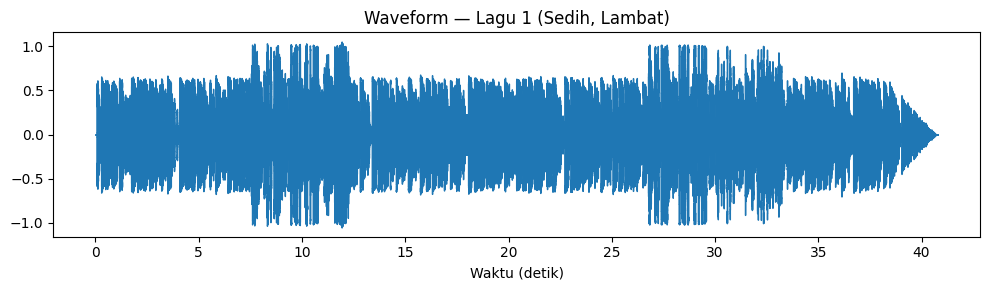

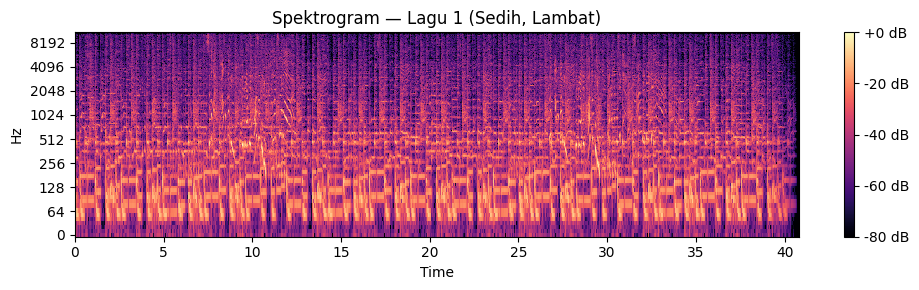

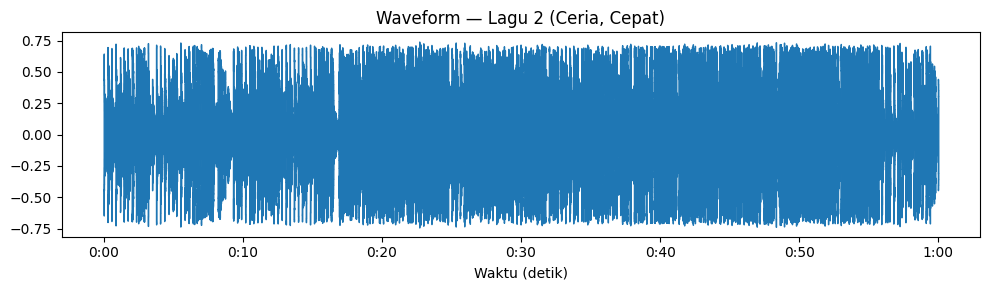

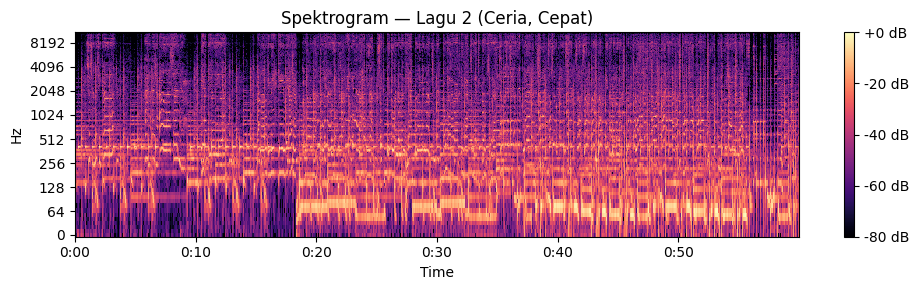

In [61]:
def show_waveform_spec(y, sr, title):
    plt.figure(figsize=(10,3))
    librosa.display.waveshow(y, sr=sr)
    plt.title(f"Waveform — {title}")
    plt.xlabel("Waktu (detik)")
    plt.tight_layout()
    plt.show()

    plt.figure(figsize=(10,3))
    S = librosa.amplitude_to_db(np.abs(librosa.stft(y)), ref=np.max)
    librosa.display.specshow(S, sr=sr, x_axis='time', y_axis='log')
    plt.title(f"Spektrogram — {title}")
    plt.colorbar(format='%+2.0f dB')
    plt.tight_layout()
    plt.show()

show_waveform_spec(y1, sr1, "Lagu 1 (Sedih, Lambat)")
show_waveform_spec(y2, sr2, "Lagu 2 (Ceria, Cepat)")


In [63]:
def analyze_music(y, sr, title):
    tempo, _ = librosa.beat.beat_track(y=y, sr=sr)

    # Ambil nilai pertama (karena tempo bisa berupa array)
    if isinstance(tempo, np.ndarray):
        tempo = float(tempo[0])

    chroma = librosa.feature.chroma_stft(y=y, sr=sr)
    chroma_mean = chroma.mean(axis=1)
    note_names = ['C', 'C#', 'D', 'D#', 'E', 'F',
                  'F#', 'G', 'G#', 'A', 'A#', 'B']
    key = note_names[np.argmax(chroma_mean)]

    print(f"🎵 {title}")
    print(f"   Tempo (BPM): {tempo:.2f}")
    print(f"   Perkiraan Kunci (Key): {key}\n")

    return tempo, key


In [64]:
target_bpm = np.mean([tempo1, tempo2])
rate1 = target_bpm / tempo1
rate2 = target_bpm / tempo2

y1_stretch = librosa.effects.time_stretch(y1, rate1)
y2_stretch = librosa.effects.time_stretch(y2, rate2)

print(f"Target BPM: {target_bpm:.2f}")
sf.write("5-1_stretch.wav", y1_stretch, sr1)
sf.write("5-2_stretch.wav", y2_stretch, sr2)


NameError: name 'tempo1' is not defined

https://github.com/rachel2140181/Multimedia